# In this notebook we will train the image starry nights with/without sine activations and see the difference

In [6]:
import torch
from torch import nn
import torch.nn.functional as F
from torch.utils.data import DataLoader, Dataset
import os

from PIL import Image
from torchvision.transforms import Resize, Compose, ToTensor, Normalize
import numpy as np
import skimage
import matplotlib.pyplot as plt

import time

def get_mgrid(sidelen, dim=2):
    '''Generates a flattened grid of (x,y,...) coordinates in a range of -1 to 1.
    sidelen: int
    dim: int'''
    tensors = tuple(dim * [torch.linspace(-1, 1, steps=sidelen)])
    mgrid = torch.stack(torch.meshgrid(*tensors), dim=-1)
    mgrid = mgrid.reshape(-1, dim)
    return mgrid

In [7]:
class SineLayer(nn.Module):
    # See paper sec. 3.2, final paragraph, and supplement Sec. 1.5 for discussion of omega_0.

    # If is_first=True, omega_0 is a frequency factor which simply multiplies the activations before the
    # nonlinearity. Different signals may require different omega_0 in the first layer - this is a
    # hyperparameter.

    # If is_first=False, then the weights will be divided by omega_0 so as to keep the magnitude of
    # activations constant, but boost gradients to the weight matrix (see supplement Sec. 1.5)

    def __init__(self, in_features, out_features, bias=True,
                 is_first=False, omega_0=30):
        super().__init__()
        self.omega_0 = omega_0
        self.is_first = is_first

        self.in_features = in_features
        self.linear = nn.Linear(in_features, out_features, bias=bias)

        self.init_weights()

    def init_weights(self):
        with torch.no_grad():
            if self.is_first:
                self.linear.weight.uniform_(-1 / self.in_features,
                                             1 / self.in_features)
            else:
                self.linear.weight.uniform_(-np.sqrt(6 / self.in_features) / self.omega_0,
                                             np.sqrt(6 / self.in_features) / self.omega_0)

    def forward(self, input):
        return torch.sin(self.omega_0 * self.linear(input))

    def forward_with_intermediate(self, input):
        # For visualization of activation distributions
        intermediate = self.omega_0 * self.linear(input)
        return torch.sin(intermediate), intermediate


class Siren(nn.Module):
    def __init__(self, in_features, hidden_features, hidden_layers, out_features, outermost_linear=False,
                 first_omega_0=30, hidden_omega_0=30.):
        super().__init__()

        self.net = []
        self.net.append(SineLayer(in_features, hidden_features,
                                  is_first=True, omega_0=first_omega_0))

        for i in range(hidden_layers):
            self.net.append(SineLayer(hidden_features, hidden_features,
                                      is_first=False, omega_0=hidden_omega_0))

        if outermost_linear:
            final_linear = nn.Linear(hidden_features, out_features)

            with torch.no_grad():
                final_linear.weight.uniform_(-np.sqrt(6 / hidden_features) / hidden_omega_0,
                                              np.sqrt(6 / hidden_features) / hidden_omega_0)

            self.net.append(final_linear)
        else:
            self.net.append(SineLayer(hidden_features, out_features,
                                      is_first=False, omega_0=hidden_omega_0))

        self.net = nn.Sequential(*self.net)

    def forward(self, coords):
        coords = coords.clone().detach().requires_grad_(True) # allows to take derivative w.r.t. input
        output = self.net(coords)
        return output, coords

    def forward_with_activations(self, coords, retain_grad=False):
        '''Returns not only model output, but also intermediate activations.
        Only used for visualizing activations later!'''
        activations = OrderedDict()

        activation_count = 0
        x = coords.clone().detach().requires_grad_(True)
        activations['input'] = x
        for i, layer in enumerate(self.net):
            if isinstance(layer, SineLayer):
                x, intermed = layer.forward_with_intermediate(x)

                if retain_grad:
                    x.retain_grad()
                    intermed.retain_grad()

                activations['_'.join((str(layer.__class__), "%d" % activation_count))] = intermed
                activation_count += 1
            else:
                x = layer(x)

                if retain_grad:
                    x.retain_grad()

            activations['_'.join((str(layer.__class__), "%d" % activation_count))] = x
            activation_count += 1

        return activations

In [8]:
def laplace(y, x):
    grad = gradient(y, x)
    return divergence(grad, x)


def divergence(y, x):
    div = 0.
    for i in range(y.shape[-1]):
        div += torch.autograd.grad(y[..., i], x, torch.ones_like(y[..., i]), create_graph=True)[0][..., i:i+1]
    return div


def gradient(y, x, grad_outputs=None):
    if grad_outputs is None:
        grad_outputs = torch.ones_like(y)
    grad = torch.autograd.grad(y, [x], grad_outputs=grad_outputs, create_graph=True)[0]
    return grad

## Cameraman image -> tensor

In [9]:
def get_cameraman_tensor(sidelength):
    img = Image.open("starry_night_512.png")
    transform = Compose([
        Resize(sidelength),
        ToTensor(),
        Normalize(torch.Tensor([0.5]), torch.Tensor([0.5]))
    ])
    img = transform(img)
    return img

In [10]:
class ImageFitting(Dataset):
    def __init__(self, sidelength):
        super().__init__()
        img = get_cameraman_tensor(sidelength)
        img = img.permute(1, 2, 0).contiguous()
        self.pixels = img.view(-1, img.shape[-1])
        self.coords = get_mgrid(sidelength, 2)

    def __len__(self):
        return 1

    def __getitem__(self, idx):
        if idx > 0: raise IndexError

        return self.coords, self.pixels

In [11]:
cameraman = ImageFitting(256)
dataloader = DataLoader(cameraman, batch_size=1, pin_memory=True, num_workers=0)

img_siren = Siren(in_features=2, out_features=1, hidden_features=256,
                  hidden_layers=3, outermost_linear=True)
img_siren.cuda()

Siren(
  (net): Sequential(
    (0): SineLayer(
      (linear): Linear(in_features=2, out_features=256, bias=True)
    )
    (1): SineLayer(
      (linear): Linear(in_features=256, out_features=256, bias=True)
    )
    (2): SineLayer(
      (linear): Linear(in_features=256, out_features=256, bias=True)
    )
    (3): SineLayer(
      (linear): Linear(in_features=256, out_features=256, bias=True)
    )
    (4): Linear(in_features=256, out_features=1, bias=True)
  )
)

Step 0, Total loss 0.177604


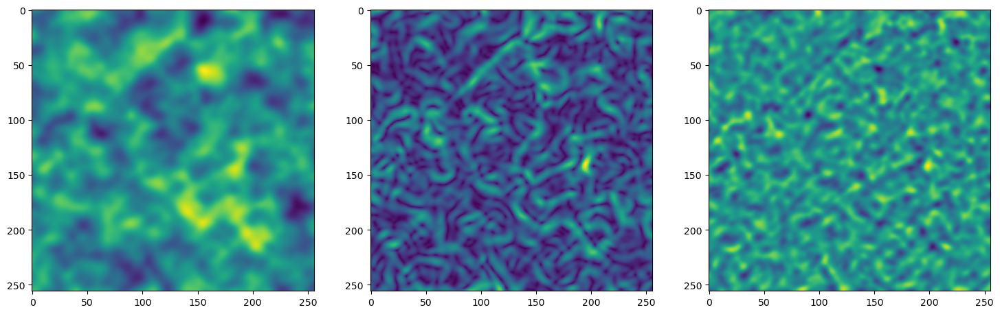

Step 10, Total loss 0.059707


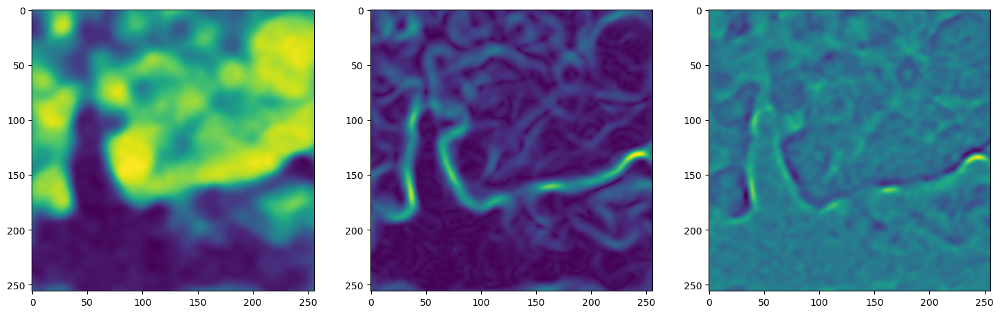

Step 20, Total loss 0.050802


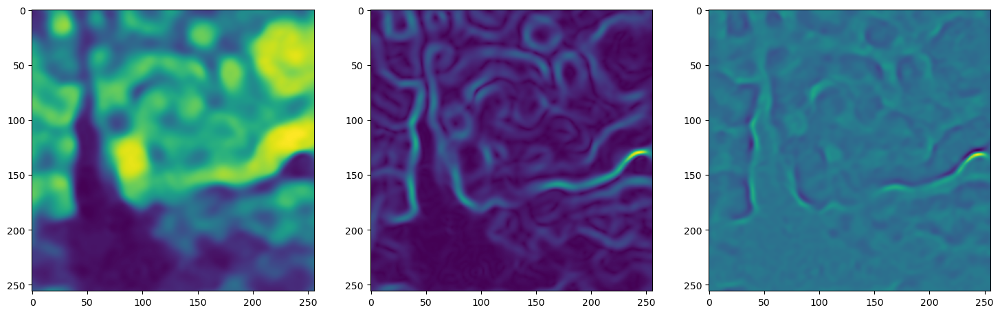

Step 30, Total loss 0.046992


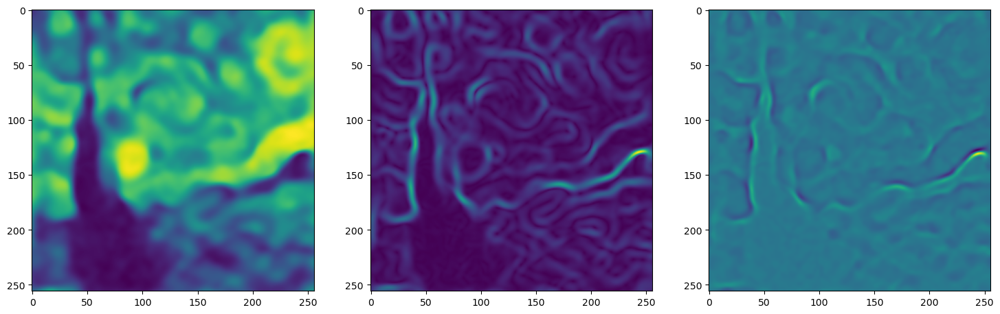

Step 40, Total loss 0.045235


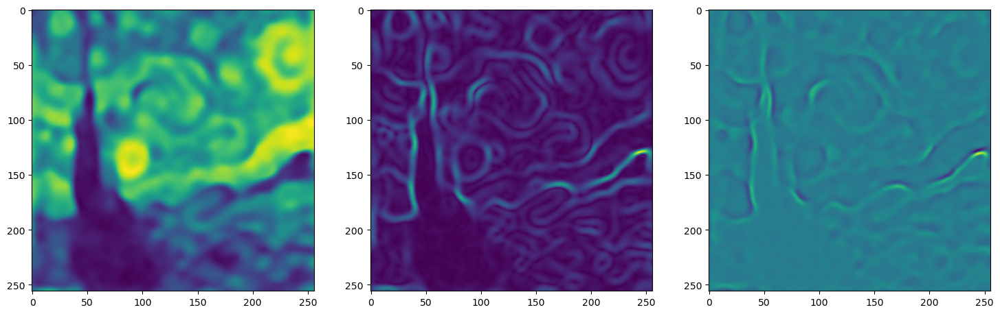

Step 50, Total loss 0.044083


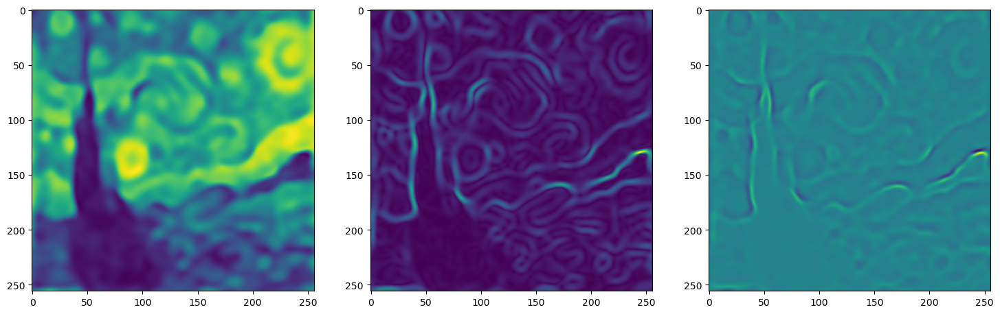

Step 60, Total loss 0.043256


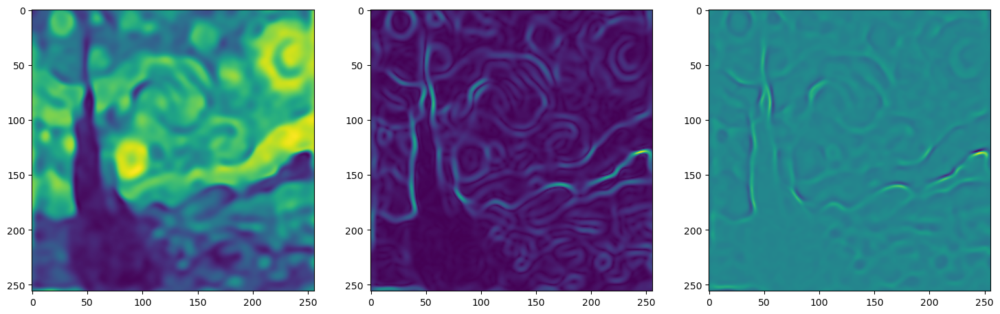

Step 70, Total loss 0.042601


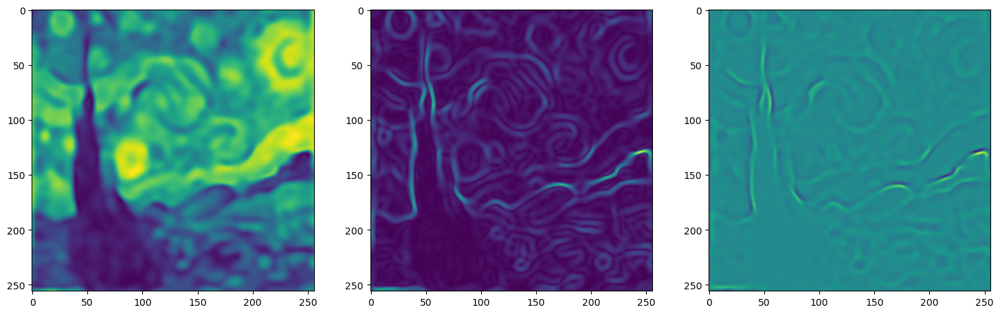

Step 80, Total loss 0.042052


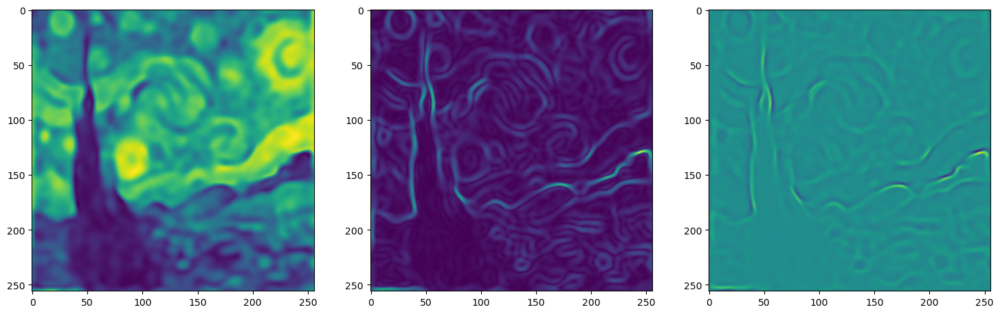

Step 90, Total loss 0.041580


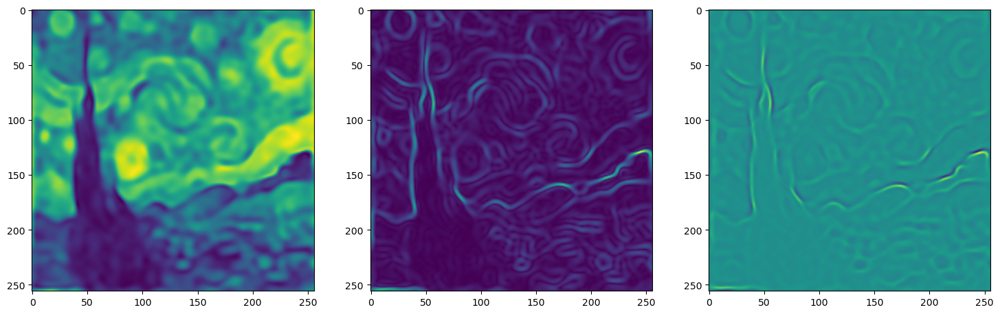

Step 100, Total loss 0.041161


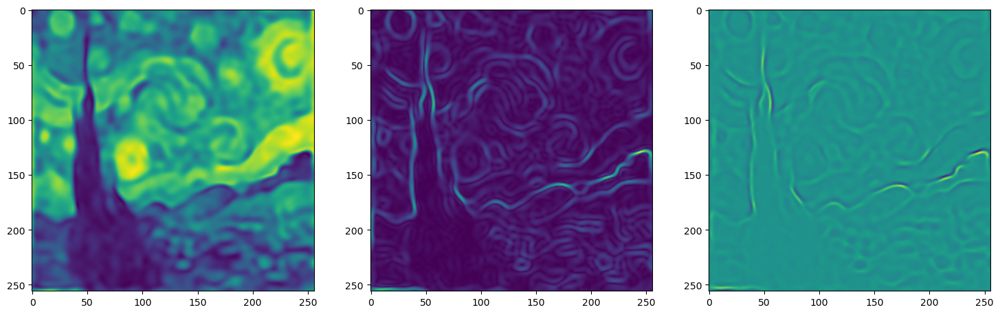

Step 110, Total loss 0.040782


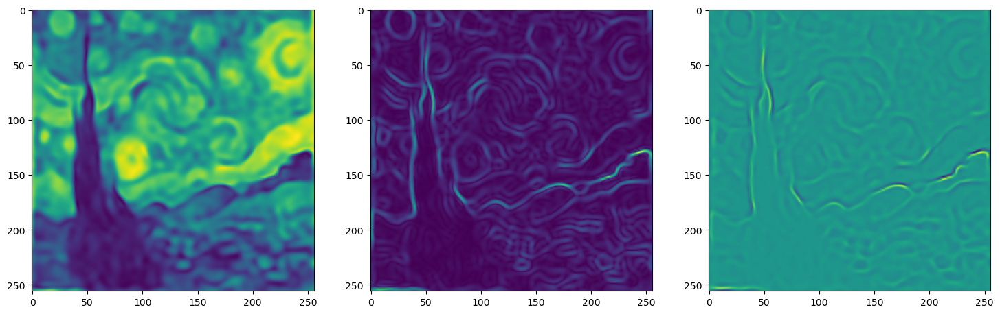

Step 120, Total loss 0.040432


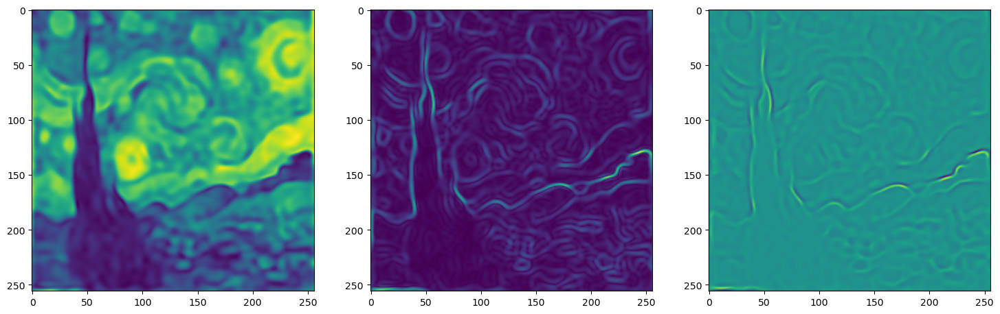

Step 130, Total loss 0.040108


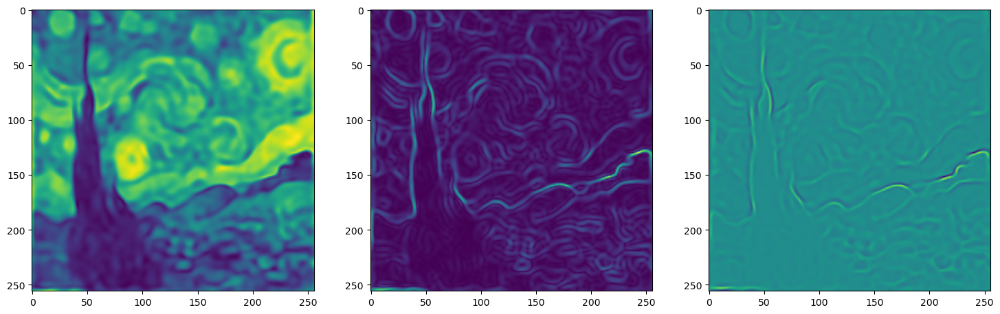

Step 140, Total loss 0.039804


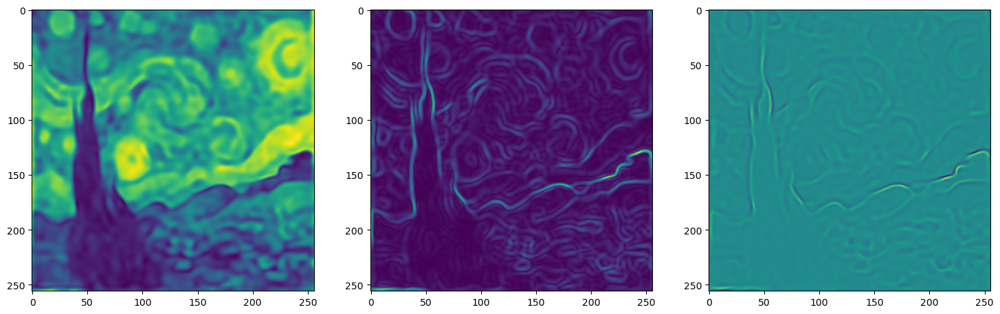

Step 150, Total loss 0.039517


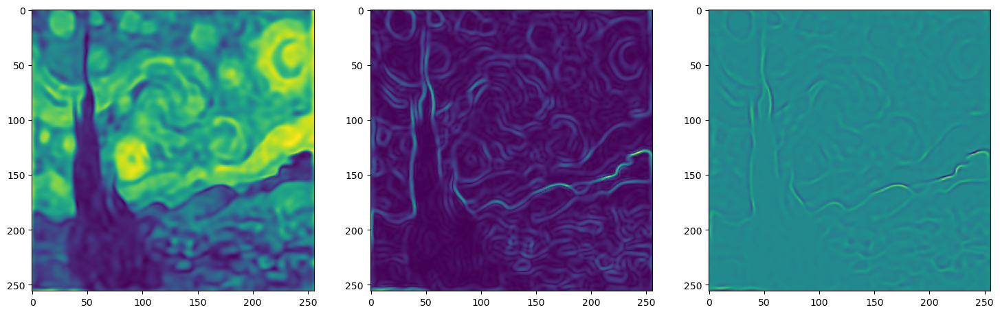

Step 160, Total loss 0.039243


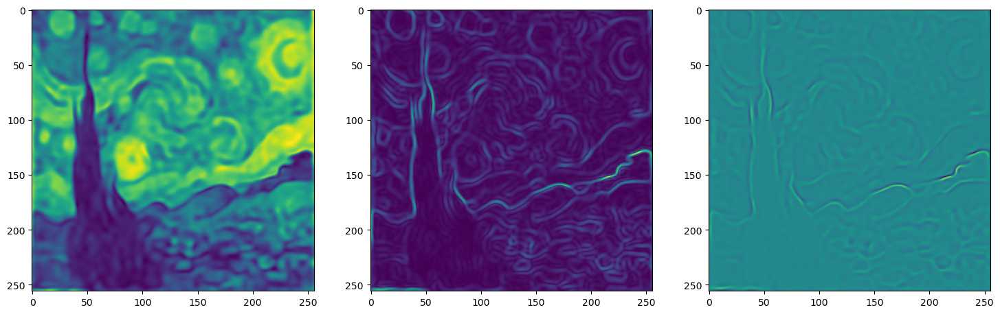

Step 170, Total loss 0.038981


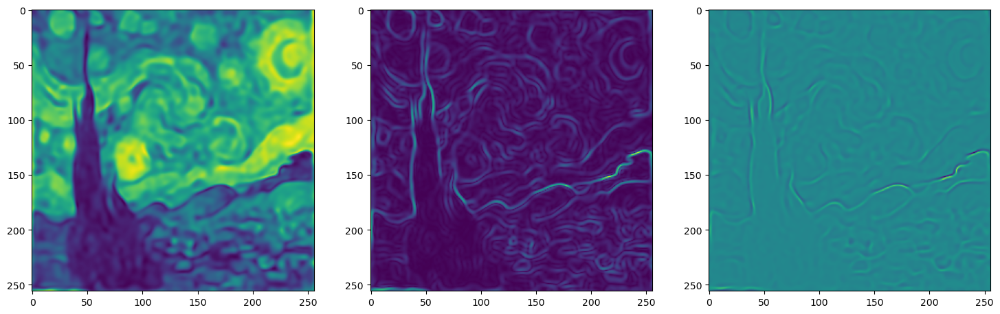

Step 180, Total loss 0.038727


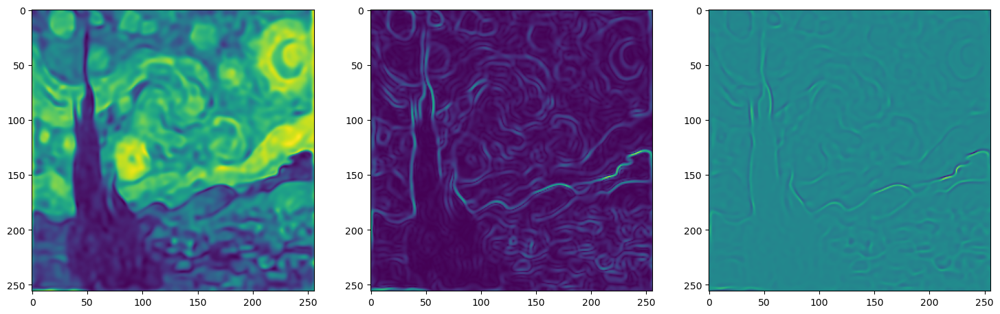

Step 190, Total loss 0.038482


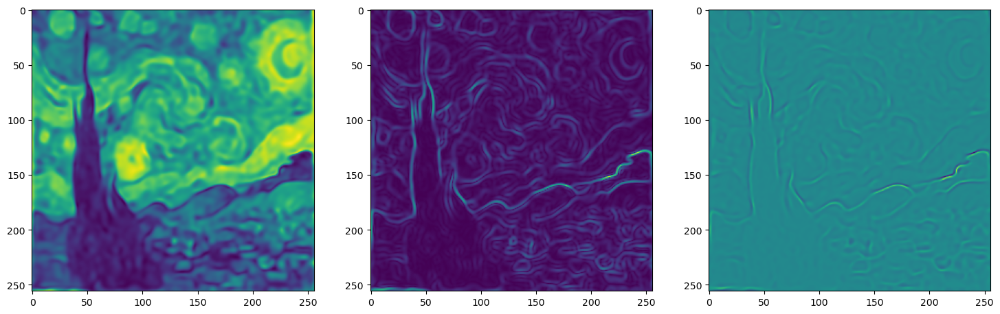

Step 200, Total loss 0.038243


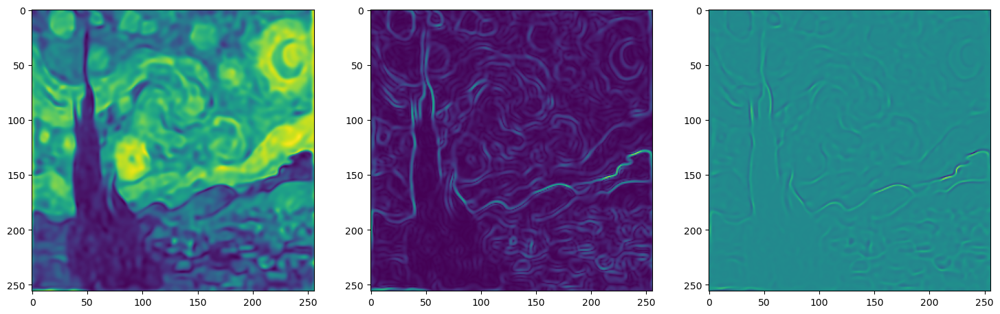

Step 210, Total loss 0.038011


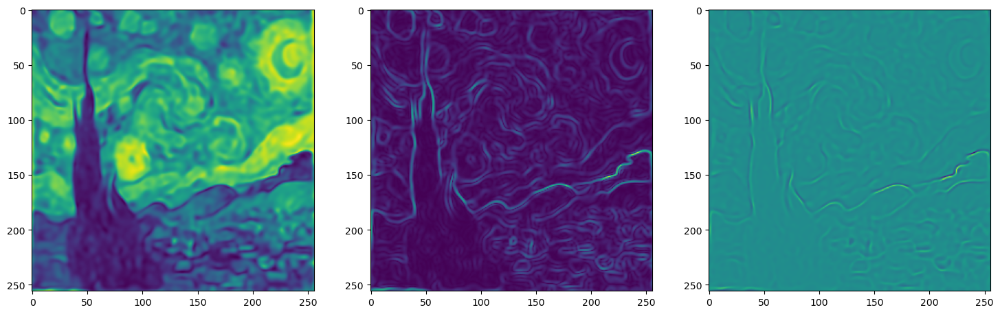

Step 220, Total loss 0.037783


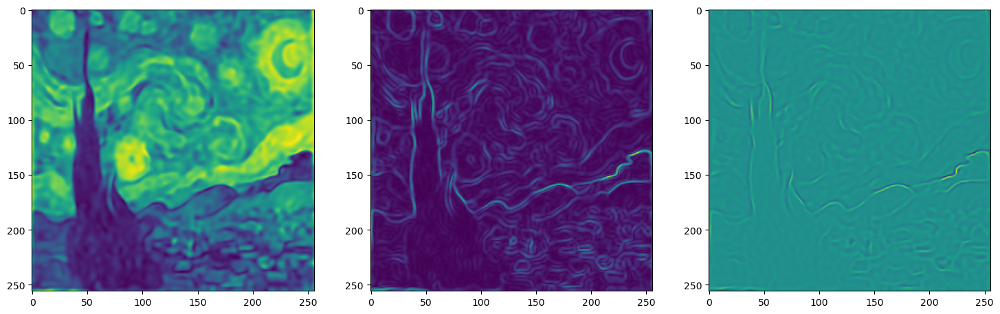

Step 230, Total loss 0.037559


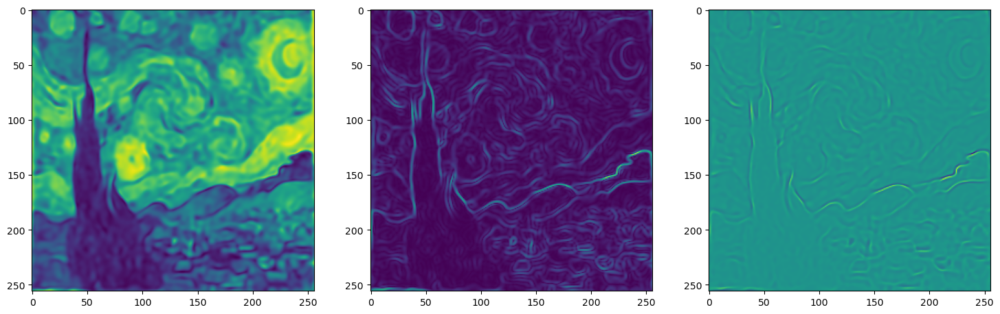

Step 240, Total loss 0.037337


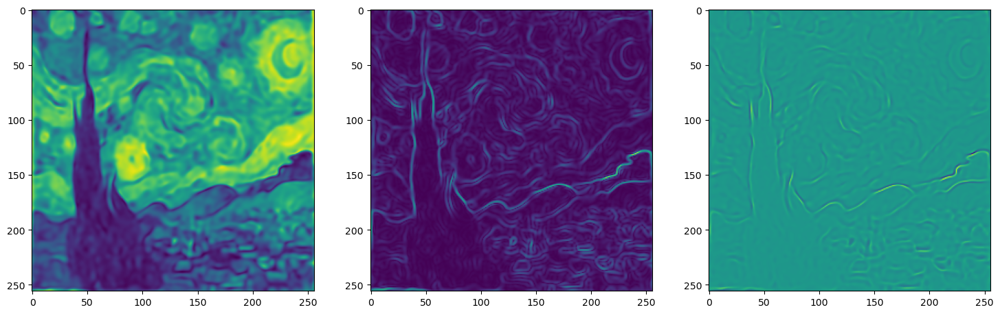

Step 250, Total loss 0.037117


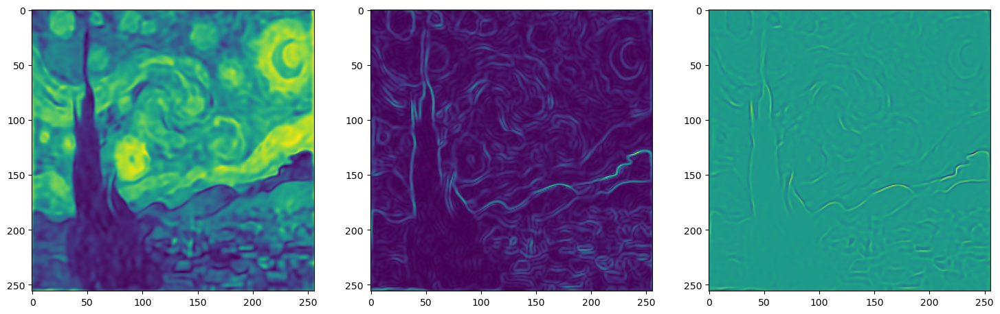

Step 260, Total loss 0.036899


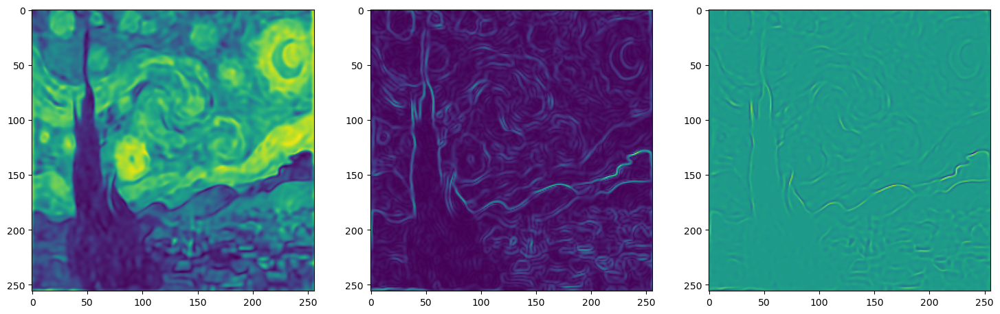

Step 270, Total loss 0.036682


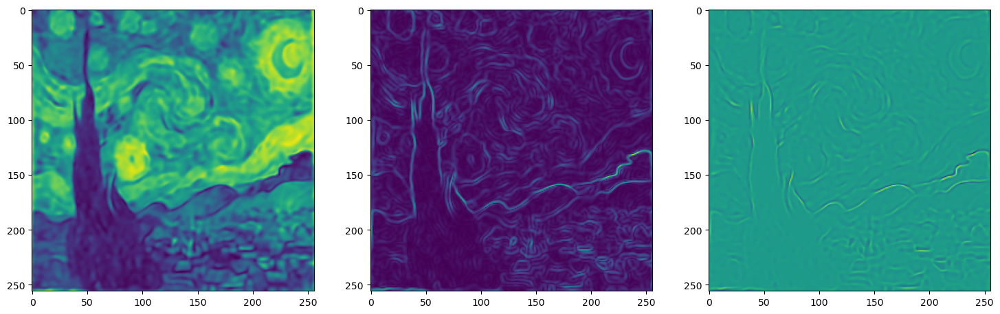

Step 280, Total loss 0.036466


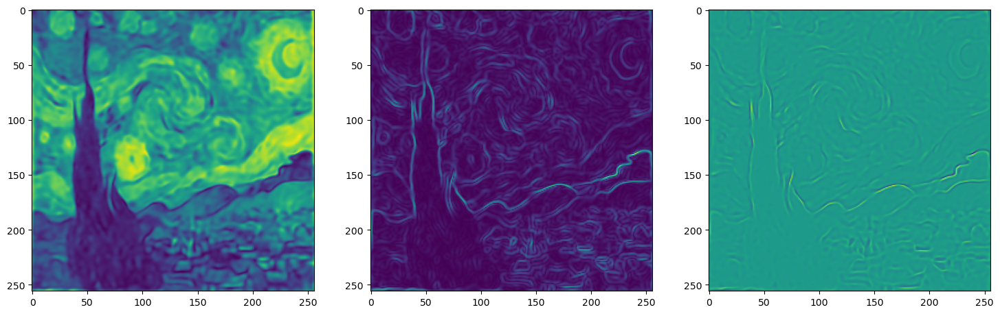

Step 290, Total loss 0.036251


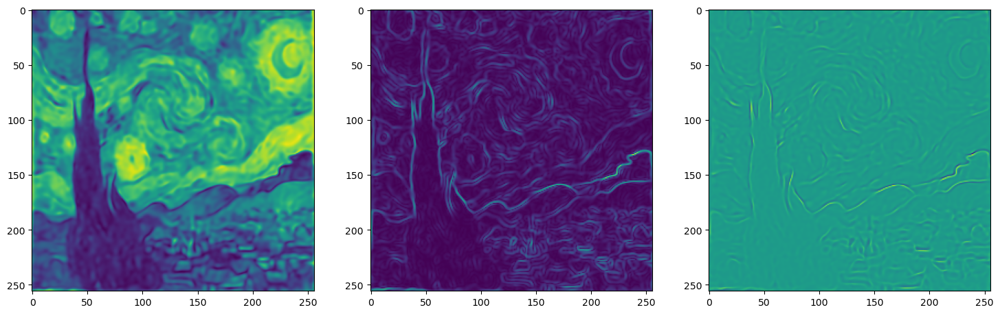

Step 300, Total loss 0.036039


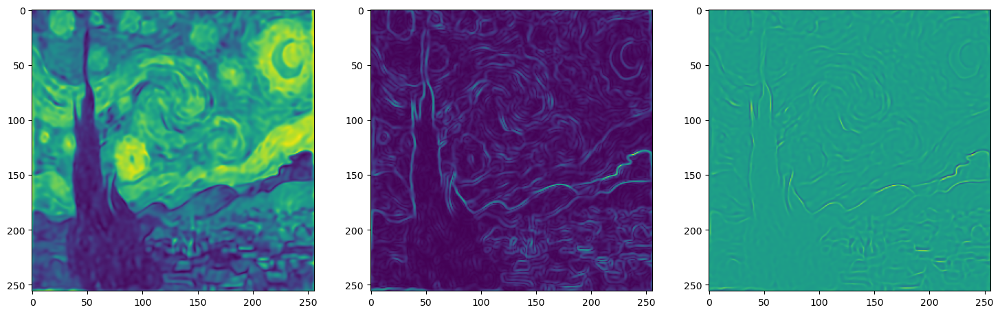

Step 310, Total loss 0.035828


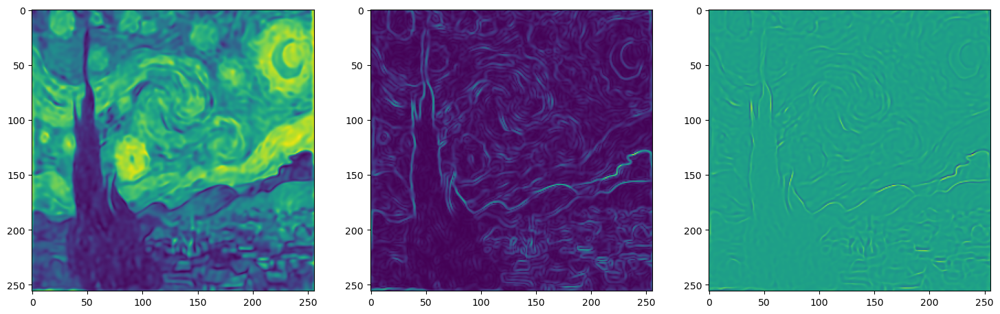

Step 320, Total loss 0.035619


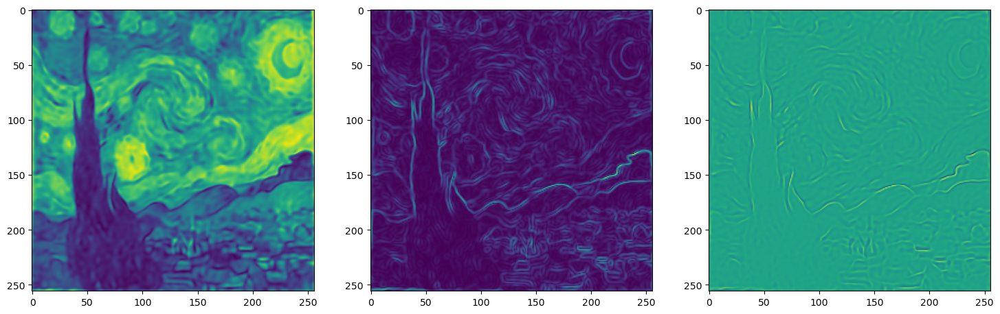

Step 330, Total loss 0.035414


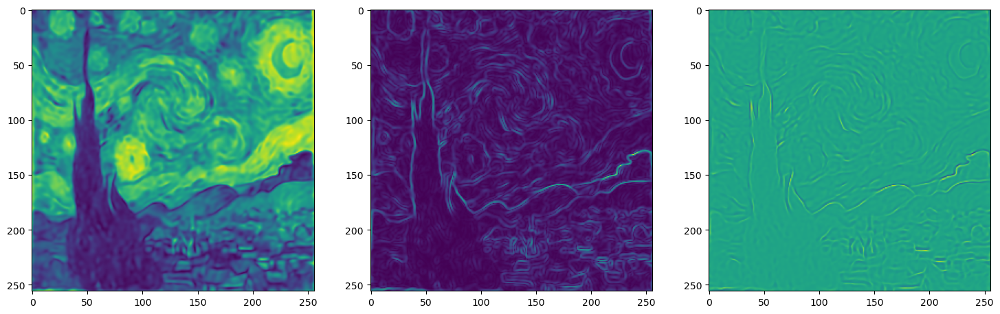

Step 340, Total loss 0.035212


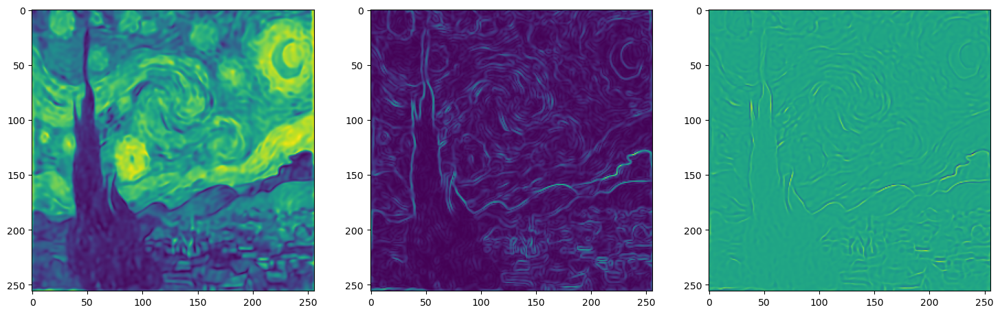

Step 350, Total loss 0.035010


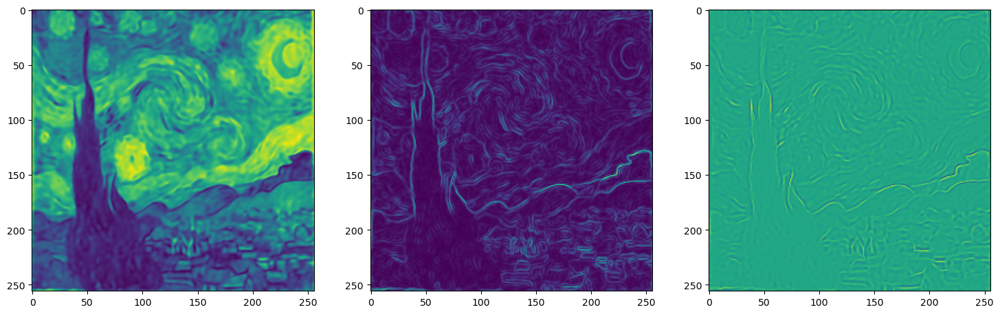

Step 360, Total loss 0.034810


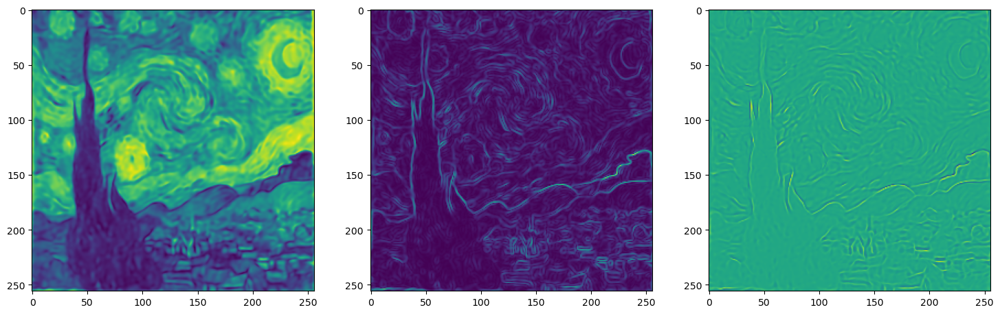

Step 370, Total loss 0.034609


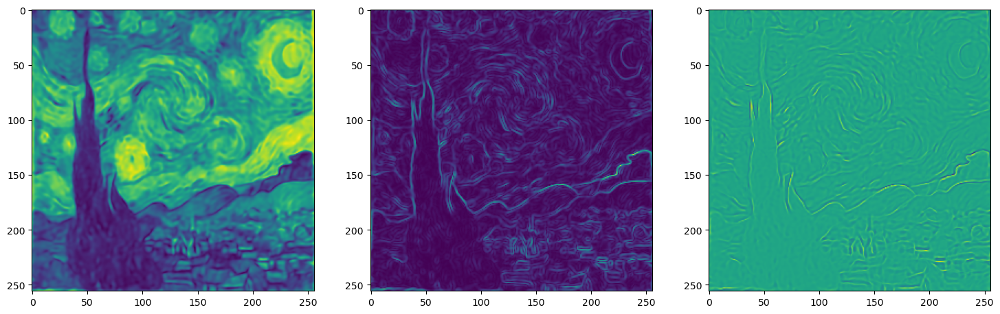

Step 380, Total loss 0.034408


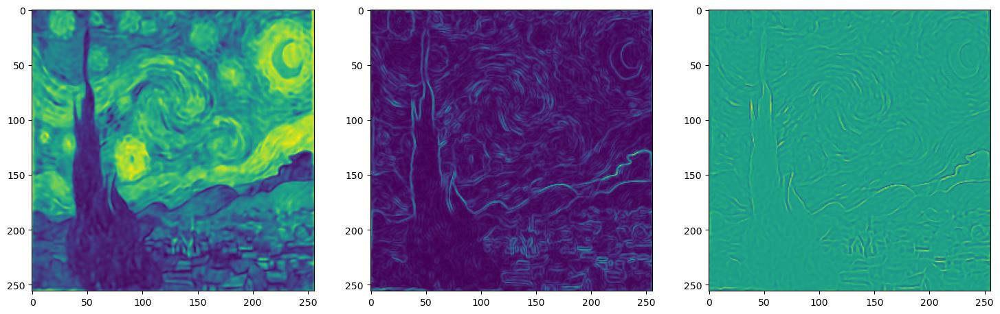

Step 390, Total loss 0.034208


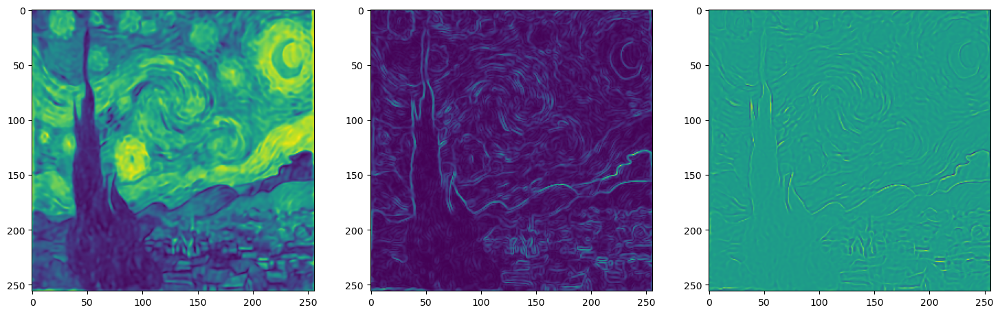

Step 400, Total loss 0.034011


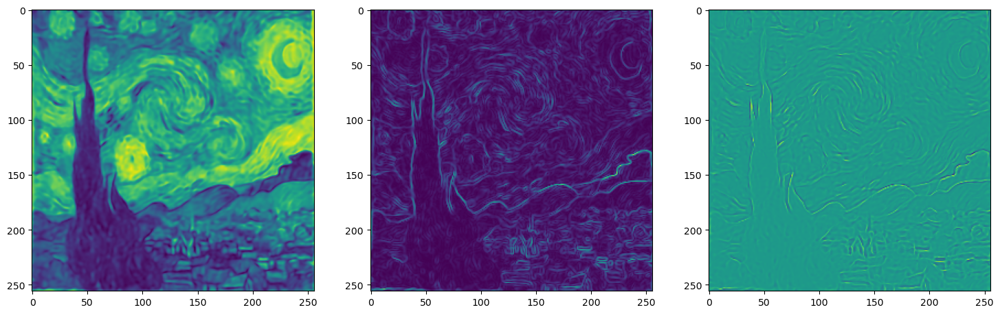

Step 410, Total loss 0.033816


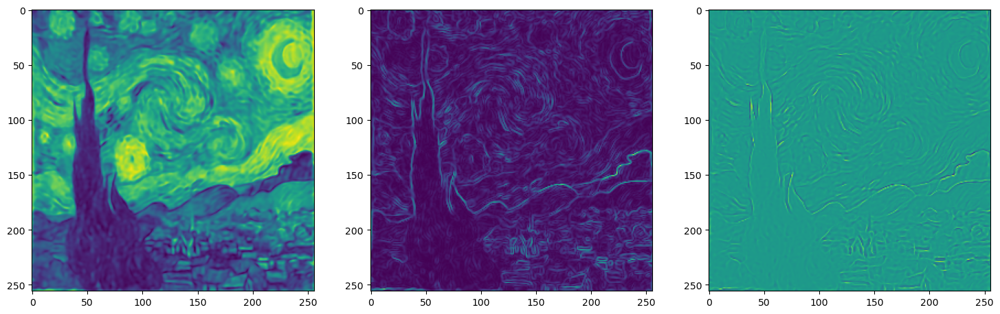

Step 420, Total loss 0.033626


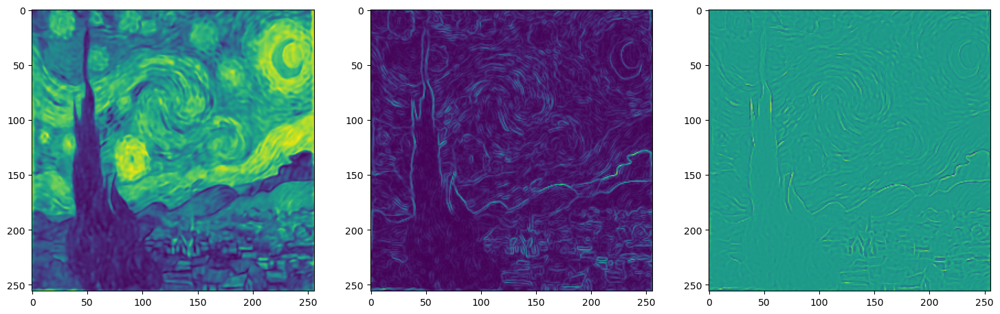

Step 430, Total loss 0.033442


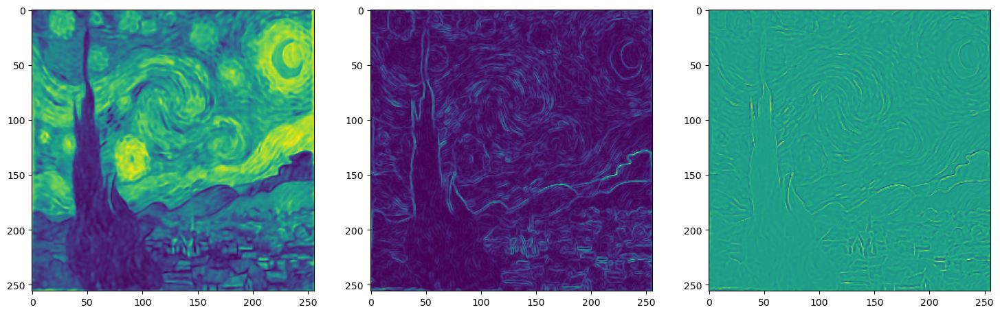

Step 440, Total loss 0.033281


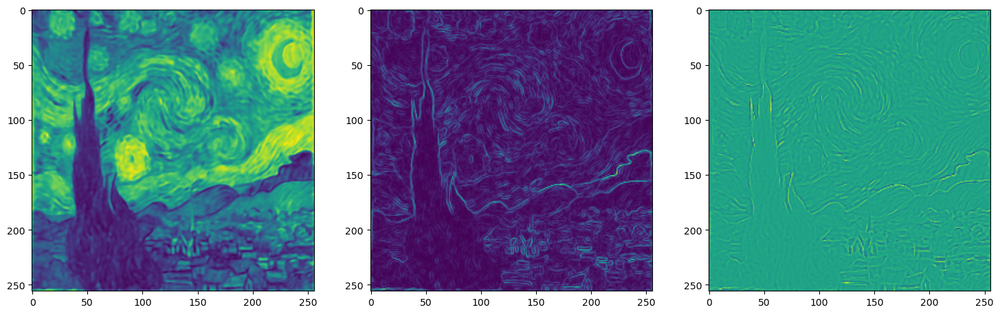

Step 450, Total loss 0.033104


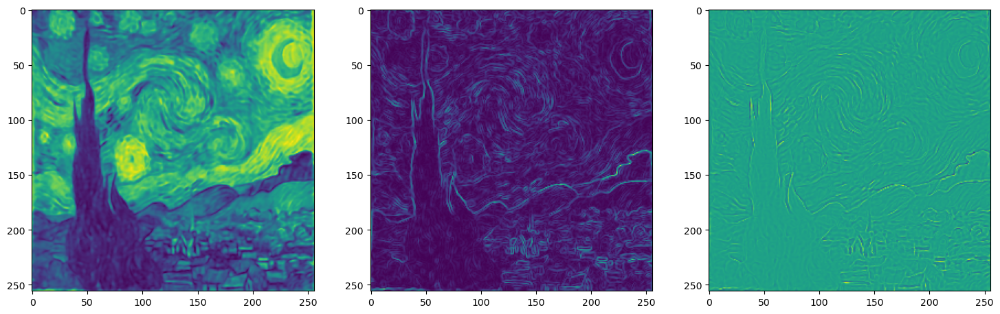

Step 460, Total loss 0.032940


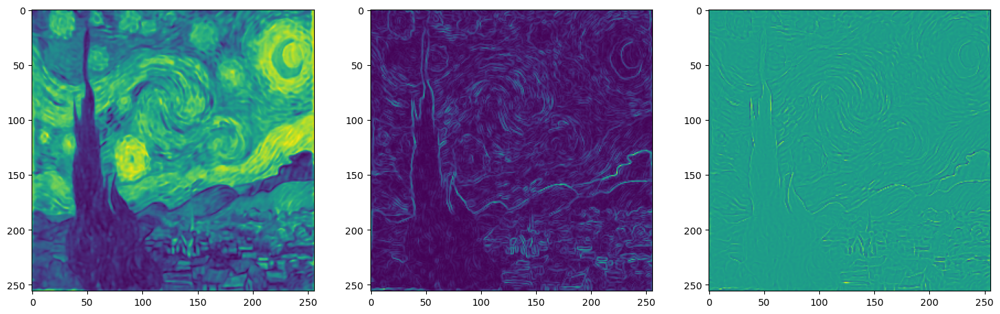

Step 470, Total loss 0.032787


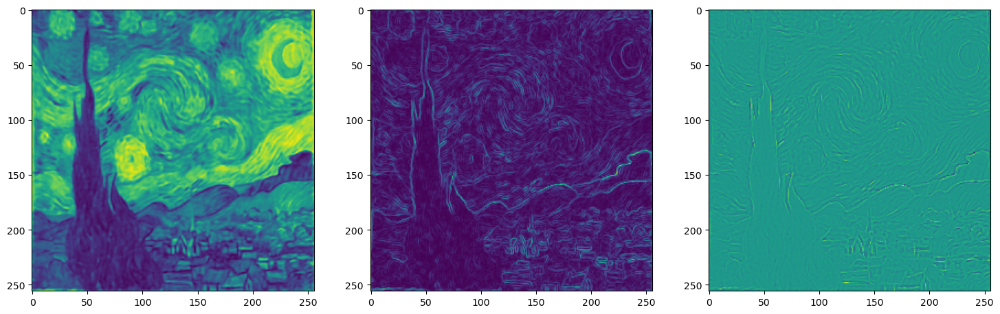

Step 480, Total loss 0.032644


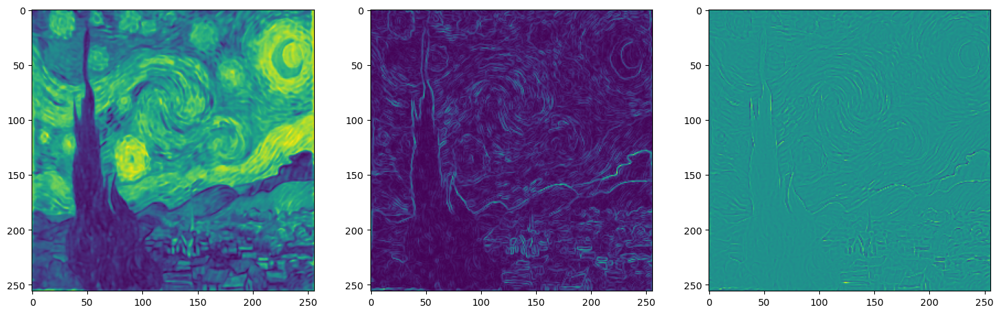

Step 490, Total loss 0.032507


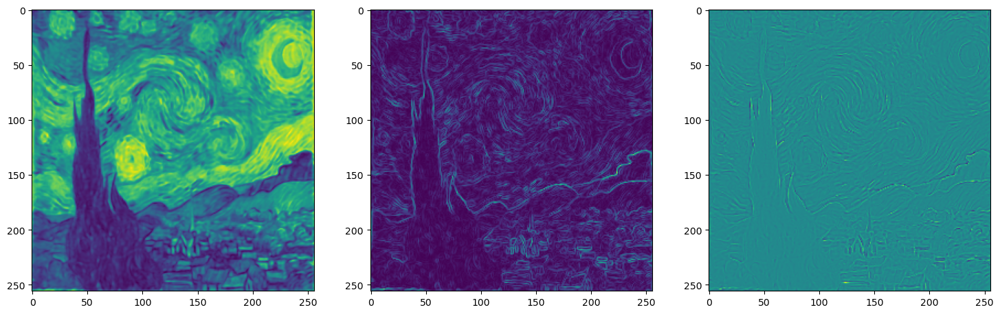

CPU times: user 33 s, sys: 336 ms, total: 33.4 s
Wall time: 32.7 s


In [12]:
%%time

total_steps = 500 # Since the whole image is our dataset, this just means 500 gradient descent steps.
steps_til_summary = 10

optim = torch.optim.Adam(lr=1e-4, params=img_siren.parameters())

model_input, ground_truth = next(iter(dataloader))
model_input, ground_truth = model_input.cuda(), ground_truth.cuda()

for step in range(total_steps):
    model_output, coords = img_siren(model_input)
    loss = ((model_output - ground_truth)**2).mean()

    if not step % steps_til_summary:
        print("Step %d, Total loss %0.6f" % (step, loss))
        img_grad = gradient(model_output, coords)
        img_laplacian = laplace(model_output, coords)

        fig, axes = plt.subplots(1,3, figsize=(18,6))
        axes[0].imshow(model_output.cpu().view(256,256).detach().numpy())
        axes[1].imshow(img_grad.norm(dim=-1).cpu().view(256,256).detach().numpy())
        axes[2].imshow(img_laplacian.cpu().view(256,256).detach().numpy())
        plt.show()

    optim.zero_grad()
    loss.backward()
    optim.step()

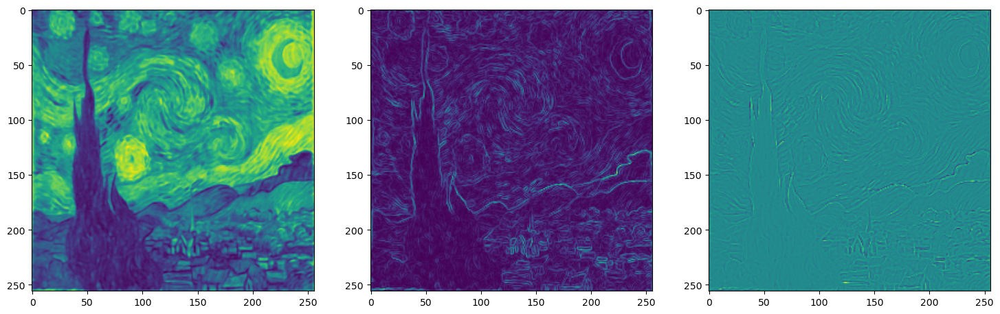

In [13]:
fig, axes = plt.subplots(1,3,figsize=(18,6))
axes[0].imshow(model_output.cpu().view(256,256).detach().numpy())
axes[1].imshow(img_grad.norm(dim=-1).cpu().view(256,256).detach().numpy(), label='\nab')
axes[2].imshow(img_laplacian.cpu().view(256,256).detach().numpy())
plt.savefig("starry_night_SIREN")

In [14]:
!nvidia-smi

Fri Dec  5 16:14:16 2025       
+---------------------------------------------------------------------------------------+
| NVIDIA-SMI 535.161.08             Driver Version: 535.161.08   CUDA Version: 12.2     |
|-----------------------------------------+----------------------+----------------------+
| GPU  Name                 Persistence-M | Bus-Id        Disp.A | Volatile Uncorr. ECC |
| Fan  Temp   Perf          Pwr:Usage/Cap |         Memory-Usage | GPU-Util  Compute M. |
|                                         |                      |               MIG M. |
|=========================================+======================+======================|
|   0  NVIDIA GeForce GTX 1080 Ti     Off | 00000000:87:00.0 Off |                  N/A |
| 23%   36C    P2              75W / 250W |   9744MiB / 11264MiB |      0%      Default |
|                                         |                      |                  N/A |
+-----------------------------------------+----------------------+--

In [15]:
!nvidia-smi --format=csv --query-gpu=memory.total,memory.used,memory.free

memory.total [MiB], memory.used [MiB], memory.free [MiB]
11264 MiB, 9744 MiB, 1428 MiB


In [ ]:
img = Image.fromarray(skimage.data.camera())
print(type(img), img.size), img

In [ ]:
from PIL import Image

# Load the image
img = Image.open("starry_night.jpg").convert("RGB")
img.size

In [ ]:
# Resize to 512x512 (preserves aspect ratio poorly — see below)
img_resized = img.resize((512, 512), Image.LANCZOS)

In [ ]:
# Save or use it
img_resized.save("starry_night_512.png")

In [ ]:
img = Image.open("starry_night_512.png").convert("RGB")
w, h = img.size
target = torch.tensor(np.array(img)).float() / 255.0  # shape H,W,3
coords = get_mgrid(h, dim=2).cuda()              # H*W,2 in [-1,1]
target_flat = target.view(-1, 3).cuda()          # H*W,3

In [ ]:
# model = Siren(dim_in=2, dim_hidden=256, dim_out=3, num_layers=5, w0=30., w0_initial=30.).to(device)
model = Siren(in_features=2, out_features=3, hidden_features=256,
                  hidden_layers=3, outermost_linear=True)
optim = torch.optim.Adam(model.parameters(), lr=1e-4)
loss_fn = torch.nn.MSELoss()

In [ ]:
total_steps = 500 # Since the whole image is our dataset, this just means 500 gradient descent steps.
steps_til_summary = 10

optim = torch.optim.Adam(lr=1e-4, params=img_siren.parameters())

model_input, ground_truth = next(iter(dataloader))
model_input, ground_truth = model_input.cuda(), ground_truth.cuda()

for step in range(total_steps):
    model_output, coords = img_siren(model_input)
    loss = ((model_output - ground_truth)**2).mean()

    if not step % steps_til_summary:
        print("Step %d, Total loss %0.6f" % (step, loss))
        img_grad = gradient(model_output, coords)
        img_laplacian = laplace(model_output, coords)

        fig, axes = plt.subplots(1,3, figsize=(18,6))
        axes[0].imshow(model_output.cpu().view(256,256).detach().numpy())
        axes[1].imshow(img_grad.norm(dim=-1).cpu().view(256,256).detach().numpy())
        axes[2].imshow(img_laplacian.cpu().view(256,256).detach().numpy())
        plt.show()

    optim.zero_grad()
    loss.backward()
    optim.step()

In [ ]:
img

## Using ReLU 

To do this, we modify implementation of sine layer and SIREN module

In [ ]:
import torch
import torch.nn as nn
import numpy as np
from collections import OrderedDict


class ReluLayer(nn.Module):
    """
    Linear layer followed by ReLU, with Kaiming initialization.
    Kept 'is_first' argument for API compatibility with SineLayer,
    but we don't need omega_0 here.
    """
    def __init__(self, in_features, out_features, bias=True, is_first=False):
        super().__init__()
        self.is_first = is_first
        self.in_features = in_features
        self.linear = nn.Linear(in_features, out_features, bias=bias)
        self.init_weights()

    def init_weights(self):
        # Kaiming (He) initialization for ReLU networks
        with torch.no_grad():
            nn.init.kaiming_uniform_(self.linear.weight, a=0.0, nonlinearity='relu')
            if self.linear.bias is not None:
                # small bias
                self.linear.bias.fill_(0.0)

    def forward(self, input):
        return torch.relu(self.linear(input))

    def forward_with_intermediate(self, input):
        # For visualization of activation distributions
        intermediate = self.linear(input)
        return torch.relu(intermediate), intermediate


class ReluNet(nn.Module):
    """
    ReLU MLP with the same interface as Siren:
    - in_features
    - hidden_features
    - hidden_layers (number of hidden layers)
    - out_features
    - outermost_linear: if True, final layer is linear, else final layer also has ReLU
    """
    def __init__(self, in_features, hidden_features, hidden_layers, out_features,
                 outermost_linear=False):
        super().__init__()

        net = []

        # First layer
        net.append(ReluLayer(in_features, hidden_features, is_first=True))

        # Hidden layers
        for _ in range(hidden_layers):
            net.append(ReluLayer(hidden_features, hidden_features, is_first=False))

        # Output layer
        if outermost_linear:
            final_linear = nn.Linear(hidden_features, out_features)
            with torch.no_grad():
                nn.init.kaiming_uniform_(final_linear.weight, a=0.0, nonlinearity='linear')
                if final_linear.bias is not None:
                    final_linear.bias.fill_(0.0)
            net.append(final_linear)
        else:
            # ReLU on output as well
            net.append(ReluLayer(hidden_features, out_features, is_first=False))

        self.net = nn.Sequential(*net)

    def forward(self, coords):
        # Same behavior as Siren: clone + requires_grad for input
        coords = coords.clone().detach().requires_grad_(True)
        output = self.net(coords)
        return output, coords

    def forward_with_activations(self, coords, retain_grad=False):
        """Returns model output + intermediate activations (like Siren)."""
        activations = OrderedDict()

        activation_count = 0
        x = coords.clone().detach().requires_grad_(True)
        activations['input'] = x

        for i, layer in enumerate(self.net):
            if isinstance(layer, ReluLayer):
                x, intermed = layer.forward_with_intermediate(x)

                if retain_grad:
                    x.retain_grad()
                    intermed.retain_grad()

                activations['_'.join((str(layer.__class__.__name__), "%d" % activation_count))] = intermed
                activation_count += 1
            else:
                # final linear layer, if outermost_linear=True
                x = layer(x)
                if retain_grad:
                    x.retain_grad()

            activations['_'.join((str(layer.__class__.__name__), "%d" % activation_count))] = x
            activation_count += 1

        return activations


In [ ]:
cameraman = ImageFitting(256)
dataloader = DataLoader(cameraman, batch_size=1, pin_memory=True, num_workers=0)

img_relu = ReluNet(in_features=2, hidden_features=256,
                   hidden_layers=3, out_features=1,
                   outermost_linear=True)
img_relu.cuda()



In [ ]:
%%time

total_steps = 500
steps_til_summary = 10

optim = torch.optim.Adam(lr=1e-4, params=img_relu.parameters())

model_input, ground_truth = next(iter(dataloader))
model_input, ground_truth = model_input.cuda(), ground_truth.cuda()

for step in range(total_steps):
    model_output, coords = img_relu(model_input)   # <-- only change is the model name
    loss = ((model_output - ground_truth)**2).mean()

    if not step % steps_til_summary:
        print("Step %d, Total loss %0.6f" % (step, loss))
        img_grad = gradient(model_output, coords)
        img_laplacian = laplace(model_output, coords)

        fig, axes = plt.subplots(1,3, figsize=(18,6))
        axes[0].imshow(model_output.cpu().view(256,256).detach().numpy())
        axes[1].imshow(img_grad.norm(dim=-1).cpu().view(256,256).detach().numpy())
        axes[2].imshow(img_laplacian.cpu().view(256,256).detach().numpy())
        plt.show()

    optim.zero_grad()
    loss.backward()
    optim.step()


## Tanh implementation

In [ ]:
class TanhLayer(nn.Module):
    def __init__(self, in_features, out_features, bias=True, is_first=False):
        """
        is_first kept for API compatibility; we don't need special init.
        """
        super().__init__()
        self.is_first = is_first
        self.linear = nn.Linear(in_features, out_features, bias=bias)
        self.init_weights()

    def init_weights(self):
        # Xavier is optimal for tanh
        with torch.no_grad():
            nn.init.xavier_uniform_(self.linear.weight)
            if self.linear.bias is not None:
                self.linear.bias.fill_(0.0)

    def forward(self, input):
        return torch.tanh(self.linear(input))

    def forward_with_intermediate(self, input):
        intermed = self.linear(input)
        return torch.tanh(intermed), intermed


In [ ]:
class TanhNet(nn.Module):
    def __init__(self, in_features, hidden_features, hidden_layers,
                 out_features, outermost_linear=False):
        super().__init__()

        net = []

        # First layer
        net.append(TanhLayer(in_features, hidden_features, is_first=True))

        # Hidden layers
        for _ in range(hidden_layers):
            net.append(TanhLayer(hidden_features, hidden_features))

        # Output layer
        if outermost_linear:
            final_linear = nn.Linear(hidden_features, out_features)
            with torch.no_grad():
                nn.init.xavier_uniform_(final_linear.weight)
                if final_linear.bias is not None:
                    final_linear.bias.fill_(0.0)
            net.append(final_linear)
        else:
            net.append(TanhLayer(hidden_features, out_features))

        self.net = nn.Sequential(*net)

    def forward(self, coords):
        coords = coords.clone().detach().requires_grad_(True)
        output = self.net(coords)
        return output, coords

    def forward_with_activations(self, coords, retain_grad=False):
        activations = OrderedDict()

        x = coords.clone().detach().requires_grad_(True)
        activations['input'] = x
        activation_count = 0

        for layer in self.net:
            if isinstance(layer, TanhLayer):
                x, intermed = layer.forward_with_intermediate(x)
                if retain_grad:
                    x.retain_grad()
                    intermed.retain_grad()
                activations[f"TanhLayer_{activation_count}"] = intermed
                activation_count += 1
            else:
                x = layer(x)
                if retain_grad:
                    x.retain_grad()
            activations[f"Layer_{activation_count}"] = x
            activation_count += 1

        return activations


In [ ]:
img_tanh = TanhNet(
    in_features=2,
    hidden_features=256,
    hidden_layers=2,
    out_features=1,
    outermost_linear=True
).cuda()


In [ ]:
%%time

total_steps = 500
steps_til_summary = 10

optim = torch.optim.Adam(lr=1e-4, params=img_tanh.parameters())

model_input, ground_truth = next(iter(dataloader))
model_input, ground_truth = model_input.cuda(), ground_truth.cuda()

for step in range(total_steps):
    model_output, coords = img_tanh(model_input)
    loss = ((model_output - ground_truth)**2).mean()

    if not step % steps_til_summary:
        print("Step %d, Total loss %0.6f" % (step, loss))
        img_grad = gradient(model_output, coords)
        img_laplacian = laplace(model_output, coords)

        fig, axes = plt.subplots(1,3, figsize=(18,6))
        axes[0].imshow(model_output.cpu().view(256,256).detach().numpy())
        axes[1].imshow(img_grad.norm(dim=-1).cpu().view(256,256).detach().numpy())
        axes[2].imshow(img_laplacian.cpu().view(256,256).detach().numpy())
        plt.show()

    optim.zero_grad()
    loss.backward()
    optim.step()
